# Tenure Change in the City of Los Angeles from 2010 to 2019

## Research Question: Do parks in the city of Los Angeles have an effect on housing prices and change in tenure from 2010 to 2019? 

My portion of the assignment is looking at renters/owners in the City of LA.I used the 2010 and 2019 ACS 5 year estimates to calculate the percent change in tenure in the City of Los Angeles. This data is in census tracts. We want to see if there is a positive/negative change in percent renters to eventually look at compared to park data. If there is negative percent change in renters (renters are leaving) when nearby park this may be an indication of gentrification. We are especially concerned with renters as they are often the first ones to feel the burden of displacement.  

Sim is working on the other half of the assignment looking at percent change in housing prices compared to parks.

ACS Data on Tenure:
* https://www.socialexplorer.com/tables/ACS2019_5yr/R13021374
* https://www.socialexplorer.com/tables/ACS2010_5yr/R13021377 

The parks data comes from the Trust for Public Land's ParkScore Map. 
* https://www.tpl.org/city/los-angeles-california 
* https://www.tpl.org/parkserve/downloads 


#### This notebook intends to show a function, loop, and spatial autocorrelation. 

### Importing and Cleaning Up Tenure and Park Data
##### This section of my notebook comes from my midterm notebook which will have more markdown included there: https://github.com/arihernandez98/GoAgs/blob/main/GroupAssignments/Tenure/Midterm.ipynb

In [2]:
import pandas as pd

# to read and visualize spatial data
import geopandas as gpd

# to provide basemaps 
import contextily as ctx

# to give more power to your figures (plots)
import matplotlib.pyplot as plt

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


Below, I bring in and cleaun up the tenure and tenure change data. Tenure is as geojson from Social Explorer which gives me the census tract data I can use to map. The Tenurechange variable is from a CSV file which utilizes a percent change formula to caculate the growth or decline in renters from 2010 to 2019 utilizing ACS 5 year estimates. I marry these files together so that the data on the CSV file can be mapped using the geojson file. 

In [3]:
tenure = gpd.read_file('acs2019_5yr_B25003_14000US06037222001.geojson')

In [4]:
tenurechange = gpd.read_file('TenurePercentChange_LACounty.csv')

In [5]:
tenure = tenure.drop([0])

In [6]:
columns_to_keep = ['geoid',
 'name',
 'B25003001',
 'B25003002',
 'B25003003', 
 'geometry'] 
tenure = tenure [columns_to_keep]

In [7]:
tenurechange.rename(columns = {'Geo_GEOID':'geoid'}, inplace = True)

In [8]:
tenure = tenure.merge(tenurechange,on='geoid')

In [9]:
tenure.rename(columns = {'geometry_x':'geometry'}, inplace = True)

In [10]:
from geopandas import GeoDataFrame

In [11]:
tenure = GeoDataFrame(tenure)

In [12]:
tenure['PC_OccupiedHousingUnits'] = tenure['PC_OccupiedHousingUnits'].astype(float)
tenure['PC_Owners'] = tenure['PC_Owners'].astype(float)
tenure['PC_Renters'] = tenure['PC_Renters'].astype(float)

Bringing in and cleaning up the parks data

In [13]:
parks = gpd.read_file('SoCalParks.zip')
parks.to_file('SoCalParks.geojson', driver='GeoJSON')

In [14]:
parks['Park_Name'] = parks ['Park_Name'].astype(str)
parks['Park_Urban'] = parks ['Park_Urban'].astype(str)
parks['Park_Desig'] = parks ['Park_Desig'].astype(str)
parks['Park_Owner'] = parks ['Park_Owner'].astype(str)
parks['Park_Local'] = parks ['Park_Local'].astype(str)
parks['Park_Manag'] = parks ['Park_Manag'].astype(str)
parks['Park_Loc_1'] = parks ['Park_Loc_1'].astype(str)
parks['Park_Statu'] = parks ['Park_Statu'].astype(str)
parks['Park_Est_D'] = parks ['Park_Est_D'].astype(str)
parks['Park_Addre'] = parks ['Park_Addre'].astype(str)
parks['Park_State'] = parks ['Park_State'].astype(str)
parks['Park_Sta_1'] = parks ['Park_Sta_1'].astype(str)
parks['Park_Count'] = parks ['Park_Count'].astype(str)   
parks['Park_Cou_1'] = parks ['Park_Cou_1'].astype(str)     
parks['Park_Place'] = parks ['Park_Place'].astype(str)
parks['Park_Pla_1'] = parks ['Park_Pla_1'].astype(str)   
parks['Park_Urb_1'] = parks ['Park_Urb_1'].astype(str)     
parks['Park_Zip'] = parks ['Park_Zip'].astype(str)
parks['Park_Bound'] = parks ['Park_Bound'].astype(str)   
parks['Park_Sourc'] = parks ['Park_Sourc'].astype(str)     
parks['Park_Feedb'] = parks ['Park_Feedb'].astype(str)
parks['Park_DateA'] = parks ['Park_DateA'].astype(str) 
parks['DataShare_'] = parks ['DataShare_'].astype(str)

Putting parks and percent change in tenure together

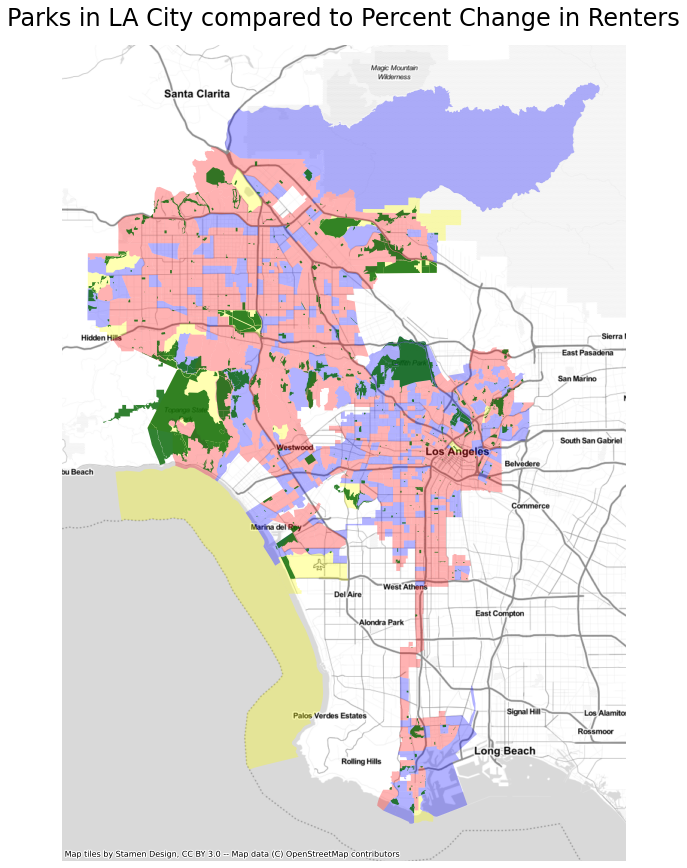

In [ ]:
parks_web_mercator = parks.to_crs(epsg=3857) 
tenure_web_mercator = tenure.to_crs(epsg=3857) 
fig, ax = plt.subplots(figsize=(15, 15))

 


tenure_web_mercator[tenure_web_mercator['PC_Renters'] < 0].plot(                                      
                                                               ax=ax,
                                                               color="blue",
                                                               alpha=0.3
)

tenure_web_mercator[tenure_web_mercator['PC_Renters'] > 0].plot(                                      
                                                               ax=ax,
                                                               color="red",
                                                               alpha=0.3
)

tenure_web_mercator[tenure_web_mercator['PC_Renters'] == 0].plot(                                      
                                                               ax=ax,
                                                               color="yellow",
                                                               alpha=0.3
)

parks_web_mercator[parks_web_mercator['Park_Place'] == 'Los Angeles city'].plot(                                      
                                                               ax=ax,
                                                               color="darkgreen",
                                                               alpha= 0.8 
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Parks in LA City compared to Percent Change in Renters',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite)

Just checking that all my work looks good from my midterm notebook and now time to move onto this week's assignment. 

 ## Spatial Autocorrelation
 
I will be attempting to do a spatial autocorrelation for parks in Los Angeles Census Tracts. 

In [44]:
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# Graphics
import matplotlib.pyplot as plt
import plotly.express as px

Looking at the Week 7 lab, it seems like I've gone pretty far in my data and have to start at the spatial join to be able to do a spatial autocorrelation. 

In [45]:
join = gpd.sjoin(parks, tenure, how='left')

/tmp/ipykernel_124/3779240842.py:1: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: ESRI:102008
Right CRS: EPSG:4326

  join = gpd.sjoin(parks, tenure, how='left')


Oh okay this is intersting. We talked a lot about projections in class and it seems like I need to make them the same in order to join them together. Looking at the lab, I need to put both of the dataframes into a web mercator projection.

In [160]:
tenure = tenure.to_crs(epsg=3857)
parks = parks.to_crs(epsg=3857)

In [161]:
join = gpd.sjoin(parks, tenure, how='left')

In [162]:
join.head()

,geoid_left,name_left,B25003001_left,B25003002_left,B25003003_left,geometry,Geo_FIPS_left,Geo_NAME_left,Geo_QName_left,Geo_STUSAB_left,...,2019_Occupied Housing Units_right,2019_Owners_right,2019_Renters_right,2010_Occupied Housing Units_right,2010_Owners_right,2010_Renters_right,PC_OccupiedHousingUnits_right,PC_Owners_right,PC_Renters_right,geometry_y_right
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,1357,535,822,1173,466,707,15.686275,14.806867,16.265912,None
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,2461,1562,899,2429,1660,769,1.317415,-5.903614,16.905072,None
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,1355,939,416,1395,1062,333,-2.867384,-11.581921,24.924925,None
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,2297,401,1896,2175,394,1781,5.609195,1.776650,6.457047,None
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,1575,843,732,1693,792,901,-6.969876,6.439394,-18.756937,None


Just a quick brainstorm on next steps:
 
I want to know if parks have an impact on percent change in renters/owners. I need to see if the number of parks in a census tract affect whether or not there is a negative/positive change in renters/owners in an area and if that value is statistically significant. 

First, I need to get a count of parks in a census tract - this may set us on a new research question: Does the NUMBER of parks affect percent change in renters/owners. Rather than looking at the size and other factors. That is probaly beyond the scope of our project anyway so just focusing on number may be easier on us anyways. 

Okay, so moving forward I need to have a dataframe with number of parks per census tract, as well as percent change in renters and owners. I'm not exactly sure how to do this because in class we only have two columns (fips and arrests) to look at but I want four: block groups, park counts, percent change in renters, and percent change in owners. But maybe for this assignment I just create a joint data frame with block groups and park counts and then overlay the map with percent change in renters in owners on another layer. 

Great. If anyone has information on how to create this new dataframe idea please let me know. Otherwise, I'm going to create a new dataframe with park counts by census tracts and then overlay that map with the percent change in renters/owners on a separate layer. 

In [171]:
parks_by_ct = join.geoid_left.value_counts().rename_axis('geoid').reset_index(name='parks_count')

In [172]:
parks_by_ct.head(20)

,geoid,parks_count
0,14000US06037980024,17
1,14000US06037980031,14
2,14000US06037206031,13
3,14000US06037701100,12
4,14000US06037208000,12
5,14000US06037207400,12
6,14000US06037219700,12
7,14000US06037134201,12
8,14000US06037123901,12
9,14000US06037211120,12


<AxesSubplot:xlabel='geoid'>

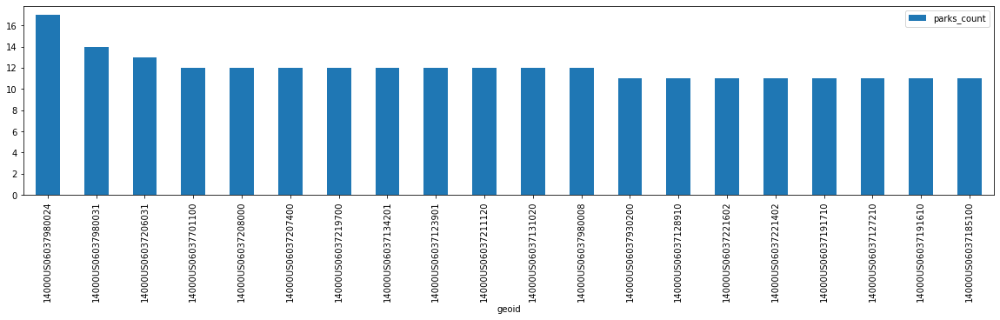

In [173]:
parks_by_ct[:20].plot.bar(figsize=(20,4),
                          x= 'geoid',
                          y='parks_count')

Yeah, as Yoh said in the lab this isn't very great unless there is a spatial component. 

In [174]:
parks=parks.merge(parks_by_ct, on ='geoid')

In [175]:
parks.sample()

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
539,14000US06037207103,"Census Tract 2071.03, Los Angeles, CA",961.0,40.0,921.0,"MULTIPOLYGON (((-13163036.864 4037492.430, -13...",6037207103,Census Tract 2071.03,"Census Tract 2071.03, Los Angeles County, Cali...",ca,...,17.338217,-11.111111,18.992248,None,6,6.243496,11.648644,-5.405148,6,6


Okay, it looks like we have a new column for park count. I'll be normalizng the data to parks per thousand people (using the 2019 occupied housing units) for 2019. I've just decided to use the 2019 data since we're doing a longitudal study and the parks data is from 2021. 

In [176]:
parks['parks_per_1000'] = parks['parks_count']/parks['2019_Occupied Housing Units']*1000

In [177]:
parks['2019_Occupied Housing Units'] = tenure['2019_Occupied Housing Units'].astype(float)

It didn't work because I needed to change the 2019 Occupied Housing Units to a float variable to be used in a math equation

In [178]:
parks['parks_per_1000'] = parks['parks_count']/parks['2019_Occupied Housing Units']*1000

In [179]:
parks.sort_values(by="parks_per_1000").tail(50)

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
31,14000US06037104703,"Census Tract 1047.03, Los Angeles, CA",572.0,213.0,359.0,"MULTIPOLYGON (((-13181239.827 4063021.718, -13...",6037104703,Census Tract 1047.03,"Census Tract 1047.03, Los Angeles County, Cali...",ca,...,8.333333,9.793814,7.485030,None,6,10.489510,8.360636,2.128874,6,6
700,14000US06037224700,"Census Tract 2247, Los Angeles, CA",949.0,18.0,931.0,"MULTIPOLYGON (((-13167304.519 4032010.858, -13...",6037224700,Census Tract 2247,"Census Tract 2247, Los Angeles County, California",ca,...,37.138728,0.000000,34.537572,None,10,10.537408,13.990855,-3.453447,10,10
693,14000US06037224020,"Census Tract 2240.20, Los Angeles, CA",943.0,49.0,894.0,"MULTIPOLYGON (((-13166257.559 4033229.280, -13...",6037224020,Census Tract 2240.20,"Census Tract 2240.20, Los Angeles County, Cali...",ca,...,18.170426,-43.023256,25.561798,None,10,10.604454,7.755396,2.849058,10,10
471,14000US06037195802,"Census Tract 1958.02, Los Angeles, CA",938.0,222.0,716.0,"MULTIPOLYGON (((-13167360.179 4039244.316, -13...",6037195802,Census Tract 1958.02,"Census Tract 1958.02, Los Angeles County, Cali...",ca,...,2.513661,11.000000,0.139860,None,10,10.660981,6.419654,4.241327,10,10
140,14000US06037120010,"Census Tract 1200.10, Los Angeles, CA",747.0,395.0,352.0,"MULTIPOLYGON (((-13187766.934 4058571.810, -13...",6037120010,Census Tract 1200.10,"Census Tract 1200.10, Los Angeles County, Cali...",ca,...,6.107955,-27.522936,121.383648,None,8,10.709505,6.198634,4.510870,8,8
548,14000US06037208301,"Census Tract 2083.01, Los Angeles, CA",556.0,0.0,556.0,"MULTIPOLYGON (((-13165492.238 4037041.198, -13...",6037208301,Census Tract 2083.01,"Census Tract 2083.01, Los Angeles County, Cali...",ca,...,0.724638,-100.000000,10.099010,None,6,10.791367,6.407396,4.383971,6,6
694,14000US06037224200,"Census Tract 2242, Los Angeles, CA",737.0,60.0,677.0,"MULTIPOLYGON (((-13167072.306 4033835.114, -13...",6037224200,Census Tract 2242,"Census Tract 2242, Los Angeles County, California",ca,...,7.748538,-33.333333,13.973064,None,8,10.854817,8.595274,2.259543,8,8
551,14000US06037208402,"Census Tract 2084.02, Los Angeles, CA",827.0,148.0,679.0,"MULTIPOLYGON (((-13165764.748 4037806.073, -13...",6037208402,Census Tract 2084.02,"Census Tract 2084.02, Los Angeles County, Cali...",ca,...,2.988792,111.428571,-7.366985,None,9,10.882709,7.077879,3.804829,9,9
699,14000US06037224600,"Census Tract 2246, Los Angeles, CA",819.0,104.0,715.0,"MULTIPOLYGON (((-13166645.730 4031629.280, -13...",6037224600,Census Tract 2246,"Census Tract 2246, Los Angeles County, California",ca,...,3.670886,-7.964602,5.612999,None,9,10.989011,14.387942,-3.398931,9,9
161,14000US06037121900,"Census Tract 1219, Los Angeles, CA",991.0,551.0,440.0,"MULTIPOLYGON (((-13178867.608 4058594.831, -13...",6037121900,Census Tract 1219,"Census Tract 1219, Los Angeles County, California",ca,...,-3.411306,-20.144928,30.952381,None,11,11.099899,7.578297,3.521602,11,11


Should I drop the census tracts with no parks? I know we did that in lab for arrests, however, I feel like it is important to have the census tracts with no parks because that in itself is very interesting to me. But not sure if statistically, that will mess things up.  

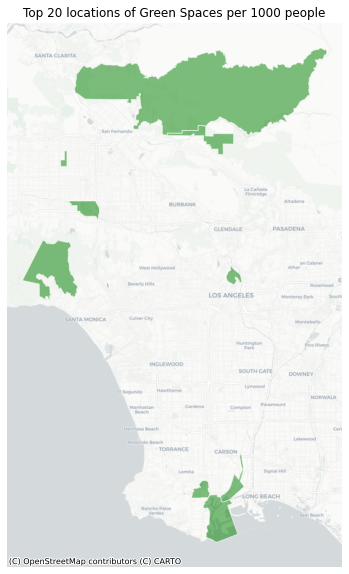

In [180]:
fig,ax = plt.subplots(figsize=(12,10))
parks.sort_values(by='parks_per_1000',ascending=False)[:10].plot(ax=ax,
                                                                 color='green',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)


# title
ax.set_title('Top 20 locations of Green Spaces per 1000 people')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

This definitely tells more of a story! We see that East Los Angeles area does not make the cut. Would love to explore more with percent change in renter and owners.

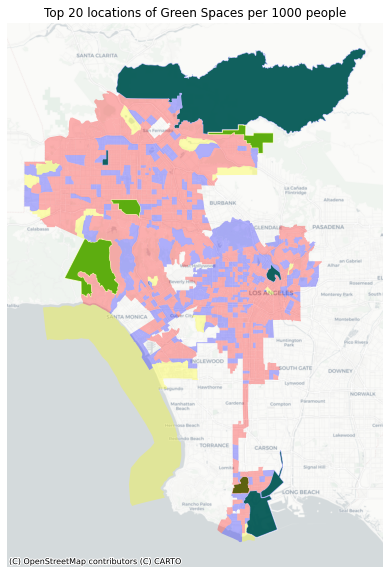

In [181]:
fig,ax = plt.subplots(figsize=(12,10))

parks.sort_values(by='parks_per_1000',ascending=False)[:10].plot(ax=ax,
                                                                 color='green',
                                                                 edgecolor='white',
                                                                 alpha=0.9,legend=True)
parks_web_mercator = parks.to_crs(epsg=3857) 

 


tenure_web_mercator[tenure_web_mercator['PC_Renters'] < 0].plot(                                      
                                                               ax=ax,
                                                               color="blue",
                                                               alpha=0.3
)

tenure_web_mercator[tenure_web_mercator['PC_Renters'] > 0].plot(                                      
                                                               ax=ax,
                                                               color="red",
                                                               alpha=0.3
)

tenure_web_mercator[tenure_web_mercator['PC_Renters'] == 0].plot(                                      
                                                               ax=ax,
                                                               color="yellow",
                                                               alpha=0.3
)


# title
ax.set_title('Top 20 locations of Green Spaces per 1000 people')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Looks like the top 20 locations of green spaces are actually closer to blue areas which indicate a decrease in renters from 2010 to 2019. However, there are still relatively close to red areas. 

Let's make a chloropleth map of parks to display which census tracts are park rich and park poor. 

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:860: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:891: RuntimeWarning:

invalid value encountered in double_scalars



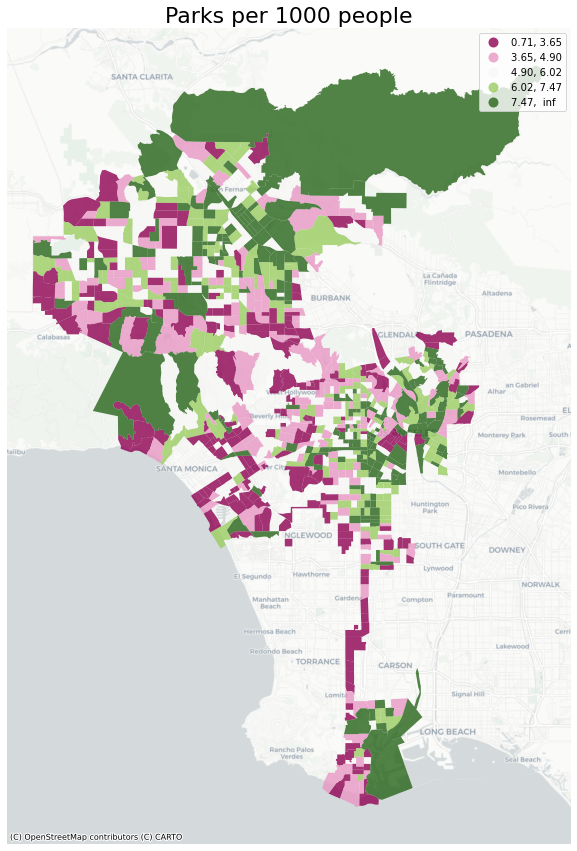

In [182]:
fig,ax = plt.subplots(figsize=(15,15))

parks.plot(ax=ax,
        column='parks_per_1000',
        legend=True,
        alpha=0.8,
        cmap='PiYG',
        scheme='quantiles')

ax.axis('off')
ax.set_title('Parks per 1000 people',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Hmm, it seems like I may need to drop census tracts with 0 people living in them or at least change something up. Inf error comes from dividing by zero so if a census tract has no oneliving it it then you get an error message when looking at parks per thousand. Would love advice on this! However, I think I should be able to keep the zero for parks but let me know if you disagree. 

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:860: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:891: RuntimeWarning:

invalid value encountered in double_scalars



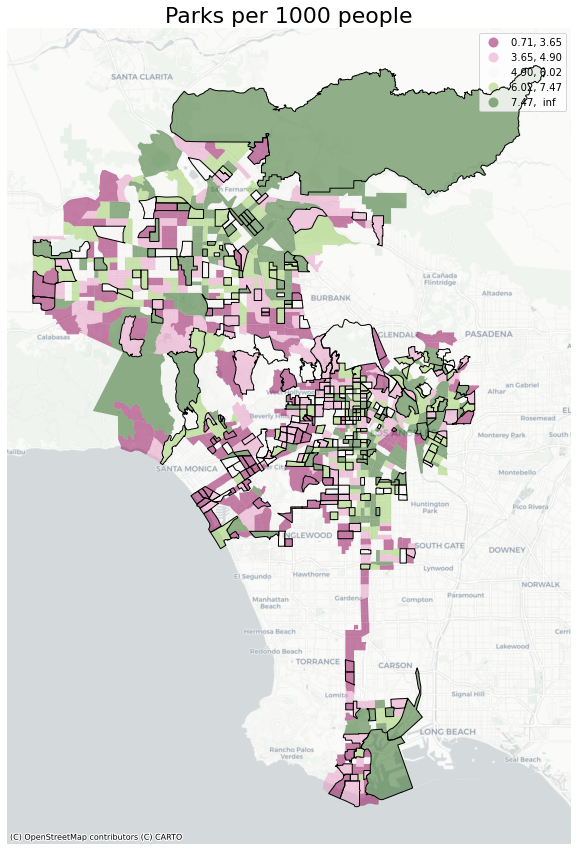

In [183]:
fig,ax = plt.subplots(figsize=(15,15))

parks.plot(ax=ax,
        column='parks_per_1000',
        legend=True,
        alpha=0.5,
        cmap='PiYG',
        scheme='quantiles')

tenure_web_mercator[tenure_web_mercator['PC_Renters'] < 0].boundary.plot(                                      
                                                               ax=ax,
                                                               color = 'black',
                                                               zorder = 30,
                                                               lw=1
)

ax.axis('off')
ax.set_title('Parks per 1000 people',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

I tried to take some creative liberties and show the census tracts which had a decrease in renters over 2010 to 2019 by creater a black border around the census tract with the parks per thousand layer underneath. I don't know if it is so compelling. I think it tells more of a story than my previous maps but still without a statistical significance, I'm not 100% sure about it. 

## Spatial Weights!!
The moment this projet has been waiting for. 

In [211]:
wq =  lps.weights.KNN.from_dataframe(parks,k=8)
wq.transform = 'r'

We're standardizing the data to see the nearest neighbors status on parks. Next, we'll look at spatial lag to take into account the park counts in census tracts from others in their "neighborhood" (which I specified as 8 nearest neighbors earlier). 

In [185]:
parks['parks_per_1000_lag'] = lps.weights.lag_spatial(wq, parks['parks_per_1000'])

In [186]:
parks.sample(10)[['geoid','PC_Renters','PC_Owners', 'parks_count','parks_per_1000','parks_per_1000_lag']]

,geoid,PC_Renters,PC_Owners,parks_count,parks_per_1000,parks_per_1000_lag
668,14000US06037220100,-8.671587,-4.448743,7,7.077856,4.571318
650,14000US06037218220,-6.521739,11.713666,6,4.106776,7.148811
623,14000US06037214100,-6.906339,3.376206,7,4.302397,4.869504
8,14000US06037102105,79.720280,-21.148825,3,5.366726,6.807565
533,14000US06037206032,28.476270,43.312102,6,3.393665,10.333633
527,14000US06037204920,26.143791,-7.119741,5,7.429421,7.373125
73,14000US06037109604,35.294118,-6.377551,8,8.714597,7.683112
442,14000US06037191820,19.210054,137.254902,7,4.830918,5.472286
296,14000US06037135111,22.144522,-10.818713,5,4.409171,4.727462
830,14000US06037262302,33.593750,-18.934348,8,6.700168,inf


Looking at entry 922, we see that that census tract has 1.4 parks per 1000 but it's neighbors have 3.7 parks per thousand. It looks like most census tracts are similar to their neighbors BUT with the donut and diamon approach we shall see. 

Next, we'll create a column that calculates the different between parks and the lag 

In [187]:
parks['parks_lag_diff'] = parks['parks_per_1000'] - parks['parks_per_1000_lag']

In [188]:
parks.sort_values(by='parks_lag_diff')

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,-6.969876,6.439394,-18.756937,None,7,4.444444,inf,-inf,7,7
830,14000US06037262302,"Census Tract 2623.02, Los Angeles, CA",1194.0,852.0,342.0,"MULTIPOLYGON (((-13190073.028 4039661.497, -13...",6037262302,Census Tract 2623.02,"Census Tract 2623.02, Los Angeles County, Cali...",ca,...,-8.645754,-18.934348,33.593750,None,8,6.700168,inf,-inf,8,8
851,14000US06037265420,"Census Tract 2654.20, Los Angeles, CA",751.0,474.0,277.0,"MULTIPOLYGON (((-13187620.103 4038594.920, -13...",6037265420,Census Tract 2654.20,"Census Tract 2654.20, Los Angeles County, Cali...",ca,...,1.486486,-17.132867,64.880952,None,7,11.475410,inf,-inf,7,7
850,14000US06037265410,"Census Tract 2654.10, Los Angeles, CA",610.0,360.0,250.0,"MULTIPOLYGON (((-13188064.379 4037795.053, -13...",6037265410,Census Tract 2654.10,"Census Tract 2654.10, Los Angeles County, Cali...",ca,...,-0.651466,4.956268,-7.749077,None,6,3.809524,inf,-inf,6,6
951,14000US06037294120,"Census Tract 2941.20, Los Angeles, CA",581.0,273.0,308.0,"MULTIPOLYGON (((-13164263.604 4001916.266, -13...",6037294120,Census Tract 2941.20,"Census Tract 2941.20, Los Angeles County, Cali...",ca,...,3.014184,50.000000,-19.371728,None,5,4.488330,inf,-inf,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
996,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",24.0,0.0,24.0,"MULTIPOLYGON (((-13168099.229 3995788.284, -13...",6037980031,Census Tract 9800.31,"Census Tract 9800.31, Los Angeles County, Cali...",ca,...,-58.620690,-100.000000,-7.692308,None,14,1750.000000,4.225750,1745.774250,14,14
992,14000US06037980019,"Census Tract 9800.19, Los Angeles, CA",65.0,53.0,12.0,"MULTIPOLYGON (((-13202401.217 4038791.402, -13...",6037980019,Census Tract 9800.19,"Census Tract 9800.19, Los Angeles County, Cali...",ca,...,62.500000,32.500000,0.000000,None,10,2000.000000,4.672643,1995.327357,10,10
847,14000US06037265303,"Census Tract 2653.03, Los Angeles, CA",1477.0,68.0,1409.0,"MULTIPOLYGON (((-13186349.837 4038248.063, -13...",6037265303,Census Tract 2653.03,"Census Tract 2653.03, Los Angeles County, Cali...",ca,...,-4.215305,23.636364,-5.245461,None,6,inf,6.605851,inf,6,6
995,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",4.0,4.0,0.0,"MULTIPOLYGON (((-13174854.541 4066507.512, -13...",6037980026,Census Tract 9800.26,"Census Tract 9800.26, Los Angeles County, Cali...",ca,...,-82.608696,-82.608696,0.000000,None,6,inf,4.463173,inf,6,6


I decided to get rid of the data that has 0 for 2019 occupied housing units bc that was giving us a divide by 0 error which wasn't helpful. 

In [189]:
parks = parks[parks['2019_Occupied Housing Units']!=0]

In [190]:
parks.sort_values(by='parks_lag_diff').head(5)

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,-6.969876,6.439394,-18.756937,None,7,4.444444,inf,-inf,7,7
849,14000US06037265305,"Census Tract 2653.05, Los Angeles, CA",1575.0,0.0,1575.0,"MULTIPOLYGON (((-13186141.669 4037398.635, -13...",6037265305,Census Tract 2653.05,"Census Tract 2653.05, Los Angeles County, Cali...",ca,...,-9.534750,-100.000000,-6.361474,None,7,8.343266,inf,-inf,7,7
848,14000US06037265304,"Census Tract 2653.04, Los Angeles, CA",839.0,0.0,839.0,"MULTIPOLYGON (((-13186140.445 4038284.347, -13...",6037265304,Census Tract 2653.04,"Census Tract 2653.04, Los Angeles County, Cali...",ca,...,-18.858801,-100.000000,-18.226121,None,4,2.708192,inf,-inf,4,4
960,14000US06037294620,"Census Tract 2946.20, Los Angeles, CA",1099.0,444.0,655.0,"MULTIPOLYGON (((-13163943.338 4000298.274, -13...",6037294620,Census Tract 2946.20,"Census Tract 2946.20, Los Angeles County, Cali...",ca,...,3.192488,-9.572301,14.111498,None,5,4.310345,inf,-inf,5,5
986,14000US06037701100,"Census Tract 7011, Los Angeles, CA",48.0,17.0,31.0,"MULTIPOLYGON (((-13187896.844 4037650.325, -13...",6037701100,Census Tract 7011,"Census Tract 7011, Los Angeles County, California",ca,...,380.000000,0.000000,210.000000,None,12,7.009346,inf,-inf,12,12


I'm not sure if I should also drop the parks per 1000 lag if it has an inf message. I don't know why it would have this issue now. 

In [191]:
parks = parks[parks['parks_per_1000_lag']!='inf']

In [192]:
parks.sort_values(by='parks_lag_diff').head(5)

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,-6.969876,6.439394,-18.756937,None,7,4.444444,inf,-inf,7,7
849,14000US06037265305,"Census Tract 2653.05, Los Angeles, CA",1575.0,0.0,1575.0,"MULTIPOLYGON (((-13186141.669 4037398.635, -13...",6037265305,Census Tract 2653.05,"Census Tract 2653.05, Los Angeles County, Cali...",ca,...,-9.534750,-100.000000,-6.361474,None,7,8.343266,inf,-inf,7,7
848,14000US06037265304,"Census Tract 2653.04, Los Angeles, CA",839.0,0.0,839.0,"MULTIPOLYGON (((-13186140.445 4038284.347, -13...",6037265304,Census Tract 2653.04,"Census Tract 2653.04, Los Angeles County, Cali...",ca,...,-18.858801,-100.000000,-18.226121,None,4,2.708192,inf,-inf,4,4
960,14000US06037294620,"Census Tract 2946.20, Los Angeles, CA",1099.0,444.0,655.0,"MULTIPOLYGON (((-13163943.338 4000298.274, -13...",6037294620,Census Tract 2946.20,"Census Tract 2946.20, Los Angeles County, Cali...",ca,...,3.192488,-9.572301,14.111498,None,5,4.310345,inf,-inf,5,5
986,14000US06037701100,"Census Tract 7011, Los Angeles, CA",48.0,17.0,31.0,"MULTIPOLYGON (((-13187896.844 4037650.325, -13...",6037701100,Census Tract 7011,"Census Tract 7011, Los Angeles County, California",ca,...,380.000000,0.000000,210.000000,None,12,7.009346,inf,-inf,12,12


I'm not sure what the issue is and why I can't get rid of the inf errors (or where they came from) but please let me know if you do know what is going on. Otherwise, I'm just going to carry on with my diamond and donut plan.

In [193]:
parks_donut = parks.sort_values(by='parks_lag_diff').head(1)

In [194]:
parks_donut

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,843.0,732.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",6037101110,Census Tract 1011.10,"Census Tract 1011.10, Los Angeles County, Cali...",ca,...,-6.969876,6.439394,-18.756937,None,7,4.444444,inf,-inf,7,7


This is the lowest value difference (if I didn't have an error message)

In [195]:
parks_diamond = parks.sort_values(by='parks_lag_diff').tail(1)
parks_diamond

,geoid,name,B25003001,B25003002,B25003003,geometry,Geo_FIPS,Geo_NAME,Geo_QName,Geo_STUSAB,...,PC_OccupiedHousingUnits,PC_Owners,PC_Renters,geometry_y,parks_count_x,parks_per_1000,parks_per_1000_lag,parks_lag_diff,parks_count_y,parks_count
992,14000US06037980019,"Census Tract 9800.19, Los Angeles, CA",65.0,53.0,12.0,"MULTIPOLYGON (((-13202401.217 4038791.402, -13...",6037980019,Census Tract 9800.19,"Census Tract 9800.19, Los Angeles County, Cali...",ca,...,62.5,32.5,0.0,None,10,2000.0,4.672643,1995.327357,10,10


that's kind of crazy to have that giant of the lag. I wonder where this census tract is at. 

Next, I'll add satellite imagery. First, I set up my token for my mapbox account

In [196]:
token = 'pk.eyJ1IjoiYWhlcm5hbmRlejk4IiwiYSI6ImNrem93eW1qcDA0ZGEydXJ4cnc3ZXBiaHoifQ.Lo9Ojm7kcfAUr5APFZ4HKA'
px.set_mapbox_access_token(token)

In [197]:
parks_diamond = parks_diamond.to_crs('epsg:4326')
parks_donut = parks_donut.to_crs('epsg:4326')

minx, miny, maxx, maxy = parks_donut.geometry.total_bounds
center_lat_donut = (maxy-miny)/2+miny
center_lon_donut = (maxx-minx)/2+minx


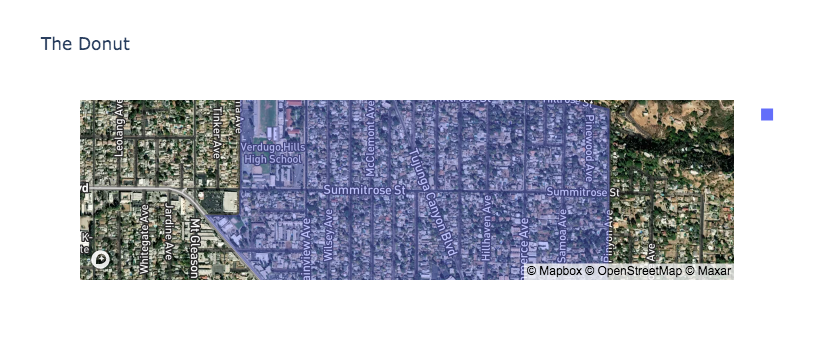

In [198]:
px.choropleth_mapbox(parks_donut, 
                     geojson=parks_donut.geometry, 
                     locations=parks_donut.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_donut, "lon": center_lon_donut},
                     hover_data=['geoid','parks_count','parks_per_1000','parks_per_1000_lag','2019_Occupied Housing Units','PC_Renters','PC_Owners'],
                     opacity=0.4,
                     title='The Donut')

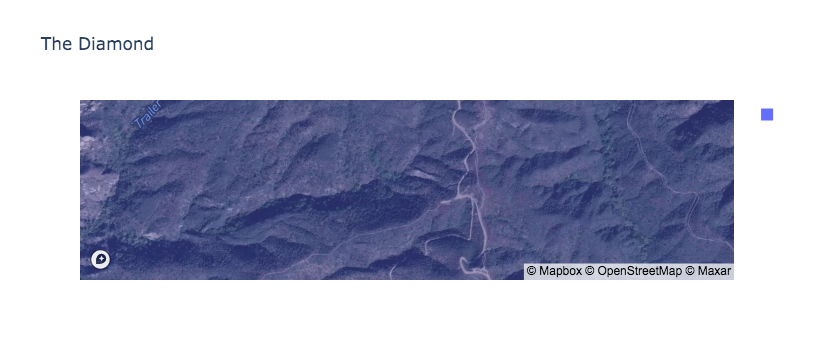

In [199]:
minx, miny, maxx, maxy = parks_diamond.geometry.total_bounds
center_lat_diamond = (maxy-miny)/2+miny
center_lon_diamond = (maxx-minx)/2+minx

px.choropleth_mapbox(parks_diamond, 
                     geojson=parks_diamond.geometry, 
                     locations=parks_diamond.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_diamond, "lon": center_lon_diamond},
                     hover_data=['geoid','parks_count','parks_per_1000','parks_per_1000_lag','2019_Occupied Housing Units','PC_Renters','PC_Owners'],
                     opacity=0.4,
                     title='The Diamond')

There is only 4 households and they have four parks. I wonder how much their homes cost. Let's make two maps of the parks per thousand and the spatial lag 

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:860: RuntimeWarning:

invalid value encountered in subtract

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:891: RuntimeWarning:

invalid value encountered in double_scalars



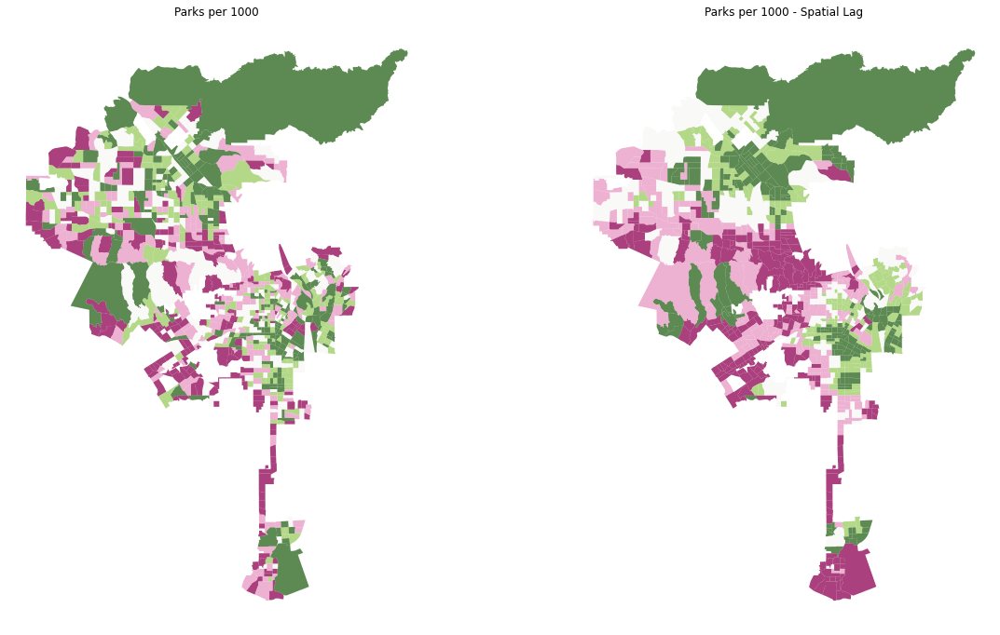

In [200]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))


parks.plot(ax=ax[0], 
         column='parks_per_1000', 
         cmap='PiYG', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )


ax[0].axis("off")
ax[0].set_title("Parks per 1000")

parks.plot(ax=ax[1], 
         column='parks_per_1000_lag', 
         cmap='PiYG', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75
           )

ax[1].axis("off")
ax[1].set_title("Parks per 1000 - Spatial Lag")

plt.show()

Now, an interactive map!

In [201]:
parks_web = parks.to_crs('EPSG:4326')

Next, I'll find the centroid because of the way plotly's map's work

In [202]:
minx, miny, maxx, maxy = parks_web.geometry.total_bounds
center_lat_parks_web = (maxy-miny)/2+miny
center_lon_parks_web = (maxx-minx)/2+minx

We'll look at stats the way we did in class. I'm interested in the actual counts though. 

In [203]:
parks_web.parks_count.describe()


count    994.000000
mean       7.057344
std        1.830625
min        2.000000
25%        6.000000
50%        7.000000
75%        8.000000
max       17.000000
Name: parks_count, dtype: float64

In [204]:
median = parks_web.parks_per_1000_lag.median()

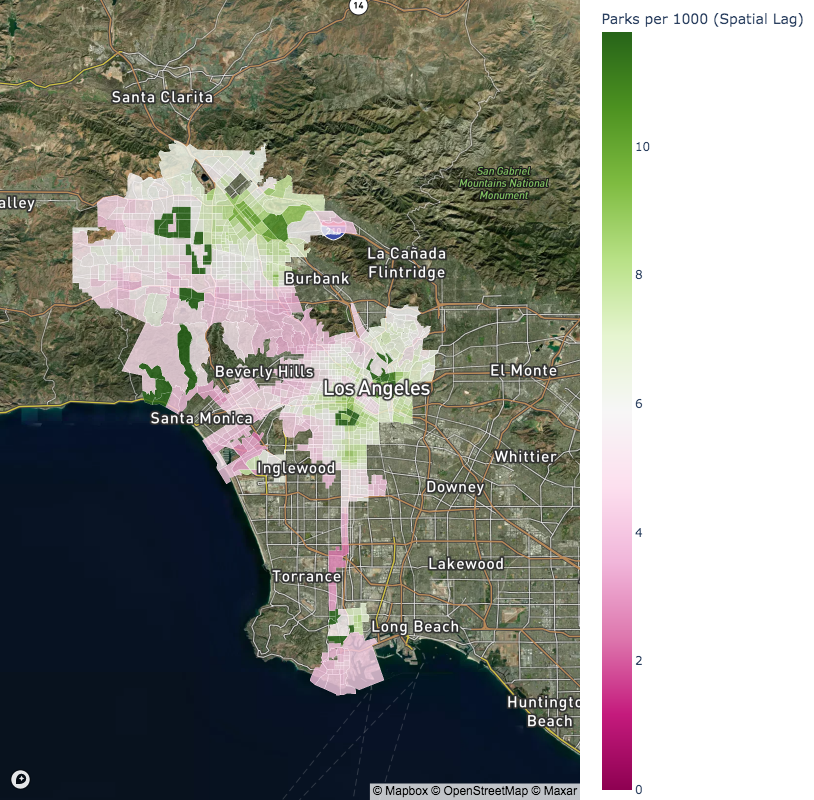

In [205]:
fig = px.choropleth_mapbox(parks_web, 
                     geojson=parks_web.geometry, # the geometry column
                     locations=parks_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='parks_per_1000_lag',
                     color_continuous_scale='PiYG',
                     color_continuous_midpoint =median, # put the median as the midpoint
                     range_color =(0,median*2),
                     hover_data=['geoid','parks_count','parks_per_1000','parks_per_1000_lag','2019_Occupied Housing Units','PC_Renters','PC_Owners'],
                     center = {"lat": center_lat_parks_web, "lon": center_lon_parks_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'parks_per_1000_lag':'Parks per 1000 (Spatial Lag)',
                             'parks_per_1000':'Parks per 1000',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

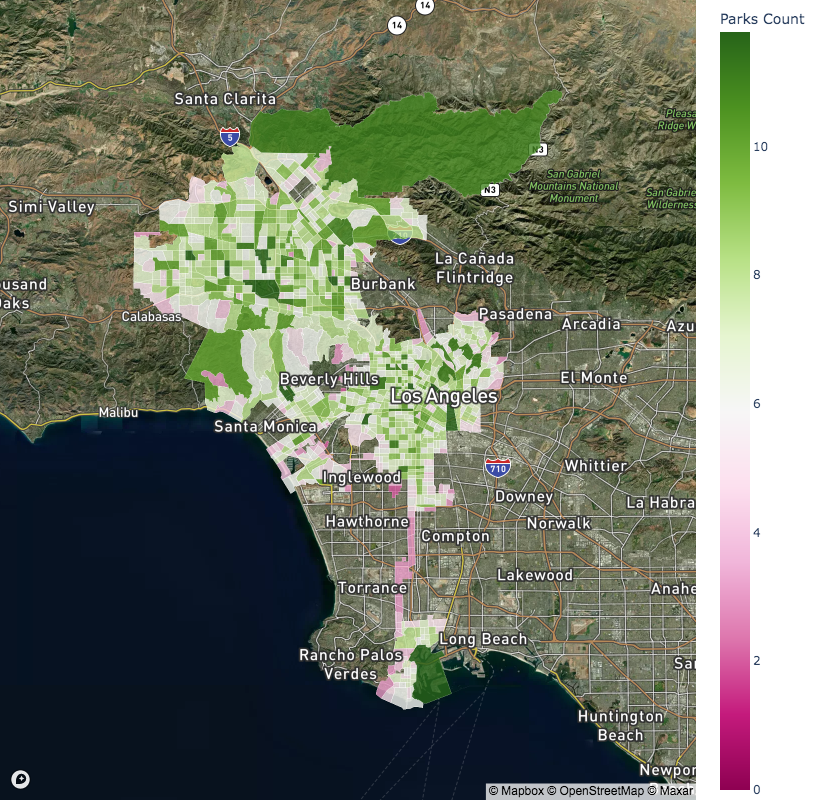

In [209]:
fig = px.choropleth_mapbox(parks_web, 
                     geojson=parks_web.geometry, # the geometry column
                     locations=parks_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='parks_count',
                     color_continuous_scale='PiYG',
                     color_continuous_midpoint =median, # put the median as the midpoint
                     range_color =(0,median*2),
                     hover_data=['geoid','parks_count','parks_per_1000','parks_per_1000_lag','2019_Occupied Housing Units','PC_Renters','PC_Owners'],
                     center = {"lat": center_lat_parks_web, "lon": center_lon_parks_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'parks_count':'Parks Count',
                             'parks_per_1000':'Parks per 1000',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

Just wanted to see an interactive map with just park counts. 

## Moran's Plot

Time to quantify the degree of the spatial correltions!

In [212]:
y = parks.parks_per_1000
moran = Moran(y, wq)
moran.I

-0.0024221407025300677

Okay, so based on my understand of Moran's I value is that it is negative (less common) so similar values are fare from each other; high values are next to low values and vice versa

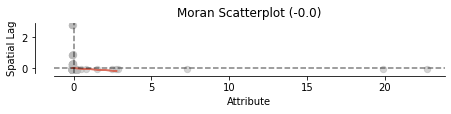

In [213]:
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

In [214]:
moran.p_sim

0.262

This seems like a high value in terms of p-value. Sigh

## Moran Local Scatterplot

In [215]:
lisa = esda.moran.Moran_Local(y, wq)

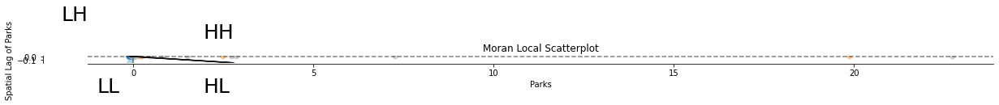

In [216]:
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisa, ax=ax, p=0.05)
ax.set_xlabel("Parks")
ax.set_ylabel('Spatial Lag of Parks')

# add some labels
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

There are hardly any statistically significant parks. 

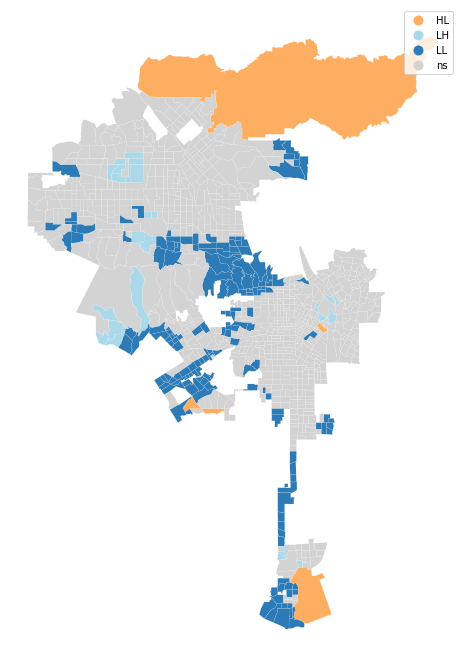

In [218]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, parks, p=0.05, ax=ax)
plt.show()

Actually, this is interesting. There are a lot of low park areas near other low park areas! A park desert if you will. 

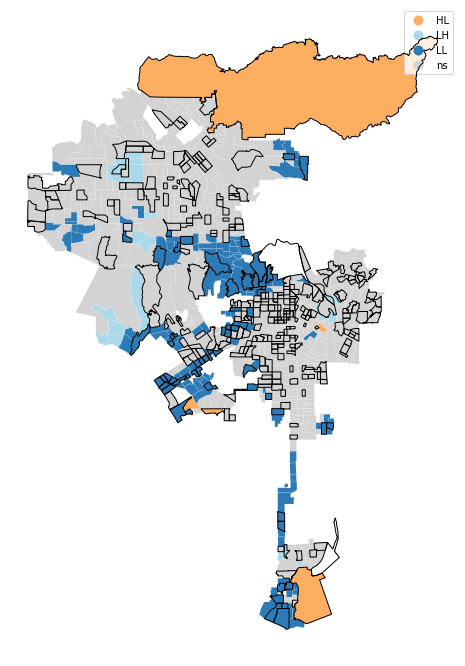

In [219]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, parks, p=0.05, ax=ax)

tenure_web_mercator[tenure_web_mercator['PC_Renters'] < 0].boundary.plot(                                      
                                                               ax=ax,
                                                               color = 'black',
                                                               zorder = 30,
                                                               lw=1
)
plt.show()

Once again, I don't really see any significance between parks and negative percent change in renters. BUT perhaps I should make a map with spatial autocorrelation for Percent change in renters and owners and see how that looks. 